# Conditional DCGAN

credits: https://machinelearningmastery.com/how-to-develop-a-conditional-generative-adversarial-network-from-scratch/

There are two motivations for making use of the class label information in a GAN architecture.

1. Improve the GAN.
2. Targeted Image Generation.

Additional information that is correlated with the input images, such as class labels, can be used to improve the GAN. This improvement may come in the form of more stable training, faster training, or generated images that have better quality.

Class labels can also be used for the deliberate or targeted generation of images of a given type.

One of the limitation of the initial GAN framework was that it could only generate a random image from the domain. There is a relationship between vectors in the latent space and the generated images, but this relationship is incomprehensible and hard to map.

Alternatively, a GAN can be trained in such a way that both the generator and the discriminator are conditioned on the class label. This means that when the trained generator is used as a standalone model to generate images in the domain, images of a given type, or class label, can be generated.

> Generative adversarial nets can be extended to a conditional model if both the generator and discriminator are conditioned on some extra information y. [...] We can perform the conditioning by feeding y into both the discriminator and generator as additional input layer.

— [Conditional Generative Adversarial Nets](https://arxiv.org/abs/1411.1784), 2014.

This type of framework is called a Conditional Generative Adversarial Network, CGAN or cGAN for short.

Conditional GAN was first described by Mehdi Mirza et al. in their 2014 paper titled "[Conditional Generative Adversarial Nets](https://arxiv.org/abs/1411.1784)." In the paper, the authors proposed the approach based on the desire to direct the image generation process of the generator model.

> ... by conditioning the model on additional information it is possible to direct the data generation process. Such conditioning could be based on class labels.

— [Conditional Generative Adversarial Nets](https://arxiv.org/abs/1411.1784), 2014.

Their approach is demonstrated in the MNIST handwritten digit dataset where the class labels are one hot encoded and concatenated with the input to both the generator and discriminator.

The image below provides a summary of the model architecture.

![CGAN Architecture](assets/cgan_architecture.png)

The conditional training of the DCGAN-based models may be referred to as CDCGAN or cDCGAN for short.

There are many ways to encode and incorporate the class labels into the discriminator and generator. The best practice so far involves using an embedding layer followed by a fully connected layer with a linear activation that scales the embedding output to the size of the image before concatenating it in the model as an additional channel for feature map. This version of recommendation was first described in the paper titled "[Deep Generative Image Models using a Laplacian Pyramid of Adversarial Networks](https://arxiv.org/abs/1506.05751)." in 2015.

> ... we also explore a class conditional version of the model, where a vector c encodes the label. This is integrated into Gk & Dk by passing it through a linear layer whose output is reshaped into a single plane feature map which is then concatenated with the 1st layer maps.

— Deep Generative Image Models using a Laplacian Pyramid of Adversarial Networks, 2015.

Also, this method was later added to the '[GAN Hacks](https://github.com/soumith/ganhacks)' list of heuristic recommendations when designing and training GAN models.

Although GANs can be conditioned on the class label, so-called class-conditional GANs, they can also be conditioned on other inputs, such as an image, where a GAN is used for image-to-image translation tasks.

In this notebook, we will develop a cDCGAN.

In [1]:
import random
from io import BytesIO

from IPython.display import HTML
%matplotlib inline
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras import Input, Model
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.datasets import fashion_mnist
from tensorflow.keras.layers import BatchNormalization, Conv2D, Conv2DTranspose, Dense, Embedding
from tensorflow.keras.layers import Concatenate, Flatten, Reshape
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.optimizers import Adam
import tensorflow.keras.utils as kutils

# Set random seed for reproducibility
manual_seed = 999
# manual_seed = random.randint(1, 10000)  # use if you want new results
print(f'Random Seed: {manual_seed}')
random.seed(manual_seed)
tf.random.set_seed(manual_seed)

Random Seed: 999


In [2]:
# Batch size during training
batch_size = 128

# Spatial size of training images
image_size = 28

# Number of channels in the training images.
nc = 1

# Number of classes in the dataset
nclasses = 10

# Size of z latent vector
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

## Fashion-MNIST Clothing Photograph Dataset

In this notebook, we will use the [Fashion-MNIST](https://github.com/zalandoresearch/fashion-mnist) dataset which is proposed as a more challening and direct replacement for the original hand-written digit dataset.

This dataset comprises 60,000 square 28x28 pixel grayscale images of 10 types of clothing, such as shoes, t-shirts, dresses, and more.

Keras provides access to the Fashion-MNIST dataset via [fashion_mnist.load_data()](https://www.tensorflow.org/api_docs/python/tf/keras/datasets/fashion_mnist/load_data) function.

Train (60000, 28, 28) (60000,)
Test (10000, 28, 28) (10000,)


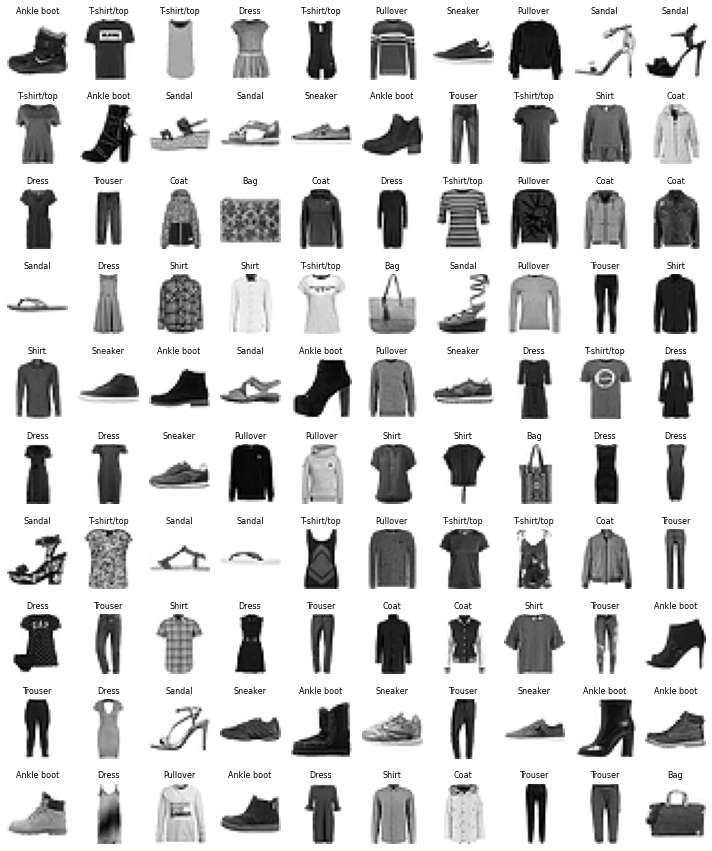

In [3]:
# Load fashion-mnist dataset
(train_x, train_y), (test_x, test_y) = fashion_mnist.load_data()
label_map = [
    'T-shirt/top',
    'Trouser',
    'Pullover',
    'Dress',
    'Coat',
    'Sandal',
    'Shirt',
    'Sneaker',
    'Bag',
    'Ankle boot'
]
# Convert images to float32 and scale them to [-1, 1]
train_x = train_x.astype(np.float32) / 127.5 - 1
test_x = test_x.astype(np.float32) / 127.5 - 1
print('Train', train_x.shape, train_y.shape)
print('Test', test_x.shape, test_y.shape)

# Create the dataset
dataset = tf.data.Dataset.from_tensor_slices((train_x, train_y))\
    .batch(batch_size)

# Plot some training images
real_image, real_label = next(iter(dataset))
fig, ax_arr = plt.subplots(10, 10, figsize=(10, 12))
k = 0
for y in range(10):
    for x in range(10):
        ax_arr[y, x].axis(False)
        ax_arr[y, x].set_title(label_map[real_label[k]], {'fontsize': 8})
        ax_arr[y, x].imshow(real_image[k], cmap='gray_r')
        k += 1
fig.tight_layout()

Weight initialization strategy is basically same as DCGAN, which uses zero-centered Normal distribution initializer with standard deviation 0.02.

In [4]:
# Custom weights initialization called on netG and netD
initializer = RandomNormal(0, 0.02)

Starting with the discriminator, a new second input is defined that takes an integer for the class label of the image. This has the effect of making the input image conditional on the provided class label.

The class label is then passed through an Embedding layer with the size of 50. This means that each of the 10 classes for the Fashin MNIST dataset will be mapped to a different 50-element vector representation that will be learned during the training phase.

The output of the embedding is then passed to a fully connected layer with a linear activation. Importantly, the fully connected layer must have enough activations so that they can be reshaped into one channel of a 28x28 image. The activations are reshaped into single 28x28 activation map and concatenated with the input image. This has the effect of making it look like a two-channel input image to the next convolution layer.

In [5]:
# Discriminator code
def build_distriminator():
    # Image input
    in_image = Input(shape=(image_size, image_size, nc), name='netD_InputImage')

    # Label input
    in_label = Input(shape=(1,), name='netD_InputLabel')
    # Embedding for categorical input
    x_label = Embedding(nclasses, 50, name='netD_Embedding')(in_label)
    # Scale up to image dimensions with linear activation
    x_label = Dense(image_size * image_size * nc, name='netD_Dense1')(x_label)
    # Reshape to image size with one channel
    x_label = Reshape((image_size, image_size, 1), name='netD_Dense1Reshape')(x_label)

    # Concatenate label as a channel
    x = Concatenate(name='netD_Concat')([in_image, x_label])

    # Downsample to 14x14
    x = Conv2D(ndf, 3, 2, 'same', use_bias=False, kernel_initializer=initializer, name='netD_Conv1')(x)
    x = BatchNormalization(name='netD_Conv1BatchNorm')(x)
    x = LeakyReLU(0.2, name='netD_Conv1LeakyReLU')(x)
    # Downsample to 7x7
    x = Conv2D(ndf * 2, 3, 2, 'same', use_bias=False, kernel_initializer=initializer, name='netD_Conv2')(x)
    x = BatchNormalization(name='netD_Conv2BatchNorm')(x)
    x = LeakyReLU(0.2, name='netD_Conv2LeakyReLU')(x)

    # Flatten feature maps
    x = Flatten(name='netD_Flatten')(x)
    # Output
    y = Dense(1, activation='sigmoid', kernel_initializer=initializer, name='netD_Prediction')(x)
    return Model([in_image, in_label], y, name='netD')


netD = build_distriminator()

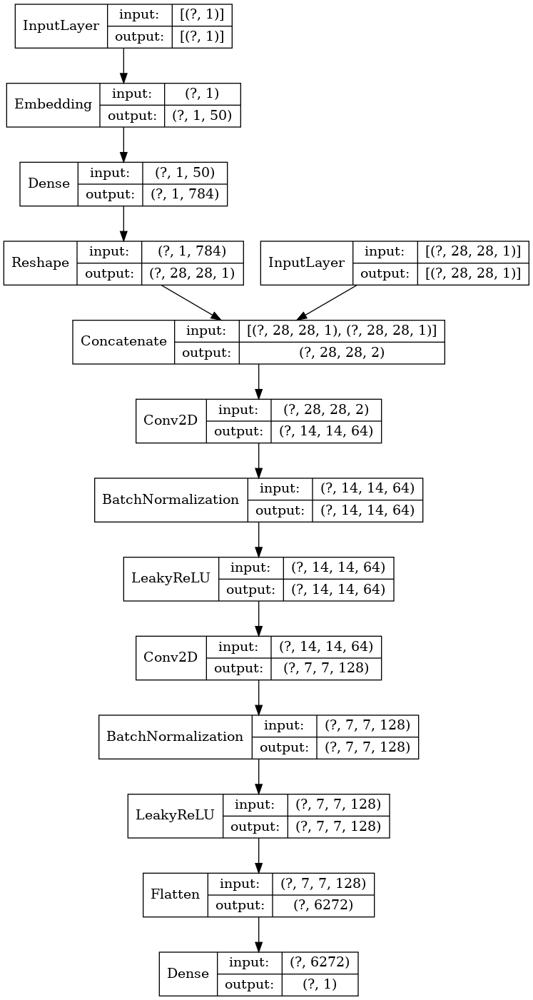

In [6]:
kutils.plot_model(netD, to_file='netD.png', show_shapes=True, show_layer_names=False)

Next, the generator is also defined to take the class label. This has the effect of making the vector in the latent space conditional on the provided class label.

As in the discriminator, the class label is passed through an embedding layer to map it to a unique 50-element vector and is then passed through a fully connected layer with a linear activation before being resized. In this case, the activations of the fully connected layer are resized into a single 7x7 feature map. The new 7x7 feature map is added as one more channel to the existing feature maps, resulting in 257 feature maps that are then upsampled.

In [7]:
# Generator code
def build_generator():
    # z latent input
    in_latent = Input(shape=(nz,), name='netG_InputLatent')
    x_latent = Dense(7 * 7 * ngf * 4, use_bias=False, kernel_initializer=initializer, name='netG_Dense2')(in_latent)
    x_latent = BatchNormalization(name='netG_Dense2BatchNorm')(x_latent)
    x_latent = LeakyReLU(0.2, name='netG_Dense2LeakyReLU')(x_latent)
    x_latent = Reshape((7, 7, ngf * 4), name='netG_Dense2Reshape')(x_latent)

    # Label input
    in_label = Input(shape=(1,), name='netG_InputLabel')
    # Embedding for categorical input
    x_label = Embedding(nclasses, 50, name='netG_Embedding')(in_label)
    # Scale up to feature dimensions with linear activation
    x_label = Dense(7 * 7, name='netG_Dense1')(x_label)
    # Reshape to feature size
    x_label = Reshape((7, 7, 1), name='netG_Dense1Reshape')(x_label)

    # Merge two inputs
    x = Concatenate(name='netG_Concat')([x_latent, x_label])

    x = Conv2DTranspose(ngf * 2, 4, 1, 'same', use_bias=False, kernel_initializer=initializer, name='netG_ConvT1')(x)
    x = BatchNormalization(name='netG_ConvT1BatchNorm')(x)
    x = LeakyReLU(0.2, name='netG_ConvT1LeakyReLU')(x)
    # Upsample to 14x14
    x = Conv2DTranspose(ngf, 4, 2, 'same', use_bias=False, kernel_initializer=initializer, name='netG_ConvT2')(x)
    x = BatchNormalization(name='netG_ConvT2BatchNorm')(x)
    x = LeakyReLU(0.2, name='netG_ConvT2LeakyReLU')(x)
    # Upsample to 28x28
    y = Conv2DTranspose(nc, 4, 2, 'same', activation='tanh', use_bias=False, kernel_initializer=initializer, name='netG_ConvT3')(x)
    return Model([in_latent, in_label], y, name='netG')


netG = build_generator()

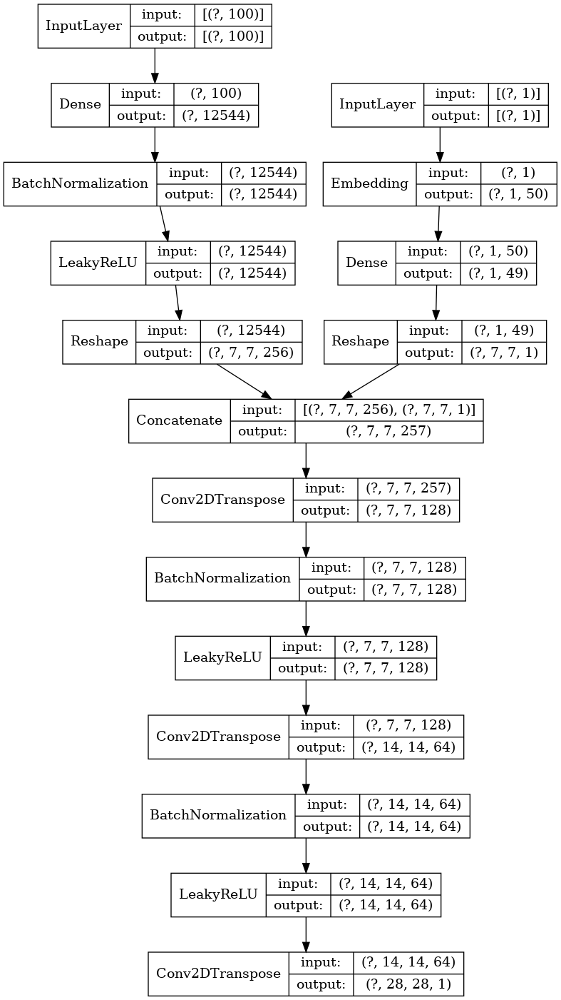

In [8]:
kutils.plot_model(netG, to_file='netG.png', show_shapes=True, show_layer_names=False)

With the discriminator and generator setup, we can specify loss functions and optimizers. We will use the Binary Cross Entropy loss function and the Adam optimizer. All hyper-parameters are set up as specified in the DCGAN paper. We also define a fixed batch of latent vectors that are drawn from a Gaussian distribution, so we can see the progress of the generator over the iterations.

In [9]:
# Initialize BCELoss function
criterion = BinaryCrossentropy(from_logits=False)

# Steup Adam optimizers for both G and D
optimizerD = Adam(learning_rate=lr, beta_1=beta1, name='optimizerD')
optimizerG = Adam(learning_rate=lr, beta_1=beta1, name='optimizerG')

# Create batch of latent vectors and labels that we will use to visualize
#  the progression of the generator
fixed_noise = tf.random.normal([100, nz])
fixed_label = tf.constant(list(range(10)) * 10, tf.int32)

In [10]:
@tf.function
def train_step(data):
    """Define training step"""
    # Format batch
    real_image, real_label = data
    batch_size = real_image.shape[0]
    # Generate batch of latent vectors and labels
    noise = tf.random.normal([batch_size, nz])
    random_label = tf.random.uniform([batch_size, 1], 0, nclasses, tf.int32)

    with tf.GradientTape(persistent=True) as tape:
        G_z = netG([noise, random_label], training=True)

        D_x = netD([real_image, real_label], training=True)
        D_G_z = netD([G_z, random_label], training=True)

        errG = criterion(tf.ones_like(D_G_z), D_G_z)
        errD = criterion(tf.ones_like(D_x), D_x) + criterion(tf.zeros_like(D_G_z), D_G_z)

    gradientsG = tape.gradient(errG, netG.trainable_variables)
    gradientsD = tape.gradient(errD, netD.trainable_variables)

    optimizerG.apply_gradients(zip(gradientsG, netG.trainable_variables))
    optimizerD.apply_gradients(zip(gradientsD, netD.trainable_variables))

    return errD, errG, tf.math.reduce_mean(D_x), tf.math.reduce_mean(D_G_z)


# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(1, num_epochs + 1):
    for i, data in enumerate(dataset, 1):
        errD, errG, D_x, D_G_z = train_step(data)

        # Output training stats
        if i % 50 == 1:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataset)}]'.ljust(20) +
                  f'Loss_D: {errD:.4f}\t'
                  f'Loss_G: {errG:.4f}\t'
                  f'D(x): {D_x:.4f}\t'
                  f'D(G(z)): {D_G_z:.4f}')

        # Save Losses for plotting later
        G_losses.append(errG.numpy())
        D_losses.append(errD.numpy())

        # Check how the generator is doing by saving G's output on fixed_noise
        if iters % 100 == 0 or (epoch == num_epochs and i == len(dataset)):
            fake = netG([fixed_noise, fixed_label], training=False)
            fake = (fake + 1) / 2
            fig, ax_arr = plt.subplots(10, 10, figsize=(10, 10))
            k = 0
            for y in range(10):
                for x in range(10):
                    ax_arr[y, x].axis(False)
                    if y == 0:
                        ax_arr[y, x].set_title(label_map[int(fixed_label[k])], {'fontsize': 8})
                    ax_arr[y, x].imshow(fake[k], cmap='gray_r')
                    k += 1
            fig.tight_layout()
            with BytesIO() as buf:
                fig.savefig(buf, format='raw')
                img = np.frombuffer(buf.getvalue(), np.uint8).reshape(int(fig.bbox.height), int(fig.bbox.width), 4)
                img_list.append(img)
            plt.close(fig)

        iters += 1

[1/10][1/469]       Loss_D: 2.0707	Loss_G: 0.7013	D(x): 0.3511	D(G(z)): 0.5394
[1/10][51/469]      Loss_D: 0.8726	Loss_G: 1.3717	D(x): 0.6224	D(G(z)): 0.2667
[1/10][101/469]     Loss_D: 1.0705	Loss_G: 1.4452	D(x): 0.6162	D(G(z)): 0.3102
[1/10][151/469]     Loss_D: 0.9993	Loss_G: 1.2301	D(x): 0.5956	D(G(z)): 0.3256
[1/10][201/469]     Loss_D: 0.7367	Loss_G: 1.3027	D(x): 0.7040	D(G(z)): 0.2908
[1/10][251/469]     Loss_D: 0.5706	Loss_G: 1.7262	D(x): 0.7357	D(G(z)): 0.2025
[1/10][301/469]     Loss_D: 0.8226	Loss_G: 2.4180	D(x): 0.5474	D(G(z)): 0.1152
[1/10][351/469]     Loss_D: 0.4912	Loss_G: 1.6539	D(x): 0.8452	D(G(z)): 0.2417
[1/10][401/469]     Loss_D: 0.3779	Loss_G: 2.3106	D(x): 0.8342	D(G(z)): 0.1488
[1/10][451/469]     Loss_D: 0.3162	Loss_G: 2.2998	D(x): 0.8793	D(G(z)): 0.1463
[2/10][1/469]       Loss_D: 0.5006	Loss_G: 2.8587	D(x): 0.6949	D(G(z)): 0.0774
[2/10][51/469]      Loss_D: 0.3772	Loss_G: 2.0594	D(x): 0.8542	D(G(z)): 0.1701
[2/10][101/469]     Loss_D: 0.3380	Loss_G: 2.8130	D(

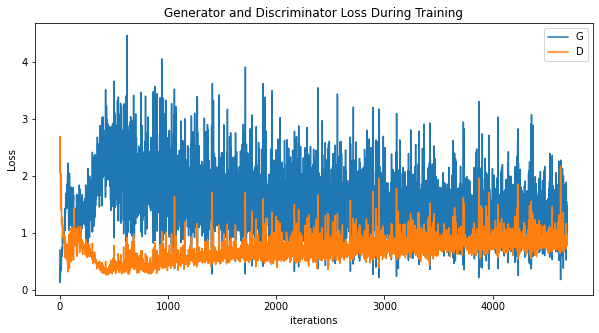

In [11]:
fig, ax = plt.subplots(figsize=(10, 5))
ax.set_title('Generator and Discriminator Loss During Training')
ax.plot(G_losses, label='G')
ax.plot(D_losses, label='D')
ax.set_xlabel('iterations')
ax.set_ylabel('Loss')
ax.legend()

In [12]:
%%capture
fig, ax = plt.subplots(figsize=(10, 10))
ax.axis(False)
ims = [[ax.imshow(i, animated=True)] for i in img_list]
fig.tight_layout()
ani = animation.ArtistAnimation(fig, ims, interval=500, repeat_delay=1000, blit=True)

In [13]:
HTML(ani.to_jshtml())